In [ ]:
import snntorch as snn
from snntorch import spikeplot as splt
from snntorch import spikegen
from snntorch import LIF
from snntorch import functional
from snntorch import surrogate

import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim

import matplotlib.pyplot as plt

import numpy as np
from numpy import load

import sys
import os


from warnings import warn
from snntorch.surrogate import atan

import pandas as pd
from copy import deepcopy
import random
import seaborn as sns

In [353]:
class RLIF1(LIF):
    def __init__(
        self,
        beta,
        V=1.0,
        all_to_all=True,
        linear_features=None,
        conv2d_channels=None,
        kernel_size=None,
        threshold=-55.0,
        spike_grad=True,
        surrogate_disable=False,
        init_hidden=False,
        inhibition=False,
        learn_beta=False,
        learn_threshold=False,
        learn_recurrent=True,  # changed learn_V
        reset_mechanism="zero",
        state_quant=False,
        output=False,
        reset_delay=True,
        v_reset=-80.0,
        refractory_period=0.0,  # in milliseconds

        # --- ADAPTATION PARAMS (comment to disable) ---
        num_excit=None,    # number of excitatory neurons
        num_iPV=None,      # number of PV interneurons
        num_iSst=None,     # number of SST interneurons
        num_iHtr=None,     # number of Htr3a interneurons
        dt=1e-3,           # simulation timestep in seconds
        # --- END ADAPTATION PARAMS ---
    ):
        super().__init__(
            beta,
            threshold,
            spike_grad,
            surrogate_disable,
            init_hidden,
            inhibition,
            learn_beta,
            learn_threshold,
            reset_mechanism,
            state_quant,
            output,
        )

        self.all_to_all = all_to_all
        self.learn_recurrent = learn_recurrent
        self.v_reset = v_reset
        self.linear_features = linear_features

        # Conv2d params
        self.kernel_size = kernel_size
        self.conv2d_channels = conv2d_channels

        # Refractory period in timesteps
        self.refractory_period = refractory_period

        # --- OPTIONS: toggle behaviors easily --------------------------------
        self.use_adaptive_threshold = True   # NEW: True → use thr_mat to fire; False → use static self.threshold
        self.use_original_memreset  = True   # NEW: True → call self.mem_reset(self.mem); False → use spike-as-reset
        # ---------------------------------------------------------------------

        # … your existing tracing, surrogate, connection init, etc. …

        # --- ADAPTATION CODE START (comment to disable) ---
        # 1) Store a per-neuron baseline threshold
        if isinstance(threshold, torch.Tensor) and threshold.ndim == 1:
            base_vec = threshold.clone().detach()
        else:
            base_val = float(threshold)
            # assume cpu if threshold not a tensor; adjust if needed
            base_vec = torch.full(
                (self.linear_features,),
                base_val,
                device=threshold.device if isinstance(threshold, torch.Tensor) else "cpu"
            )
        self.register_buffer("thr_base", base_vec)

        # 2) Make sure you passed the counts
        if None in (num_excit, num_iPV, num_iSst, num_iHtr):
            raise ValueError(
                "Please provide num_excit, num_iPV, num_iSst and num_iHtr for adaptation."
            )
        N = self.linear_features

        # 3) Define (tau, bump) per class
        tau_pv,  inc_pv  = 0.05, 5.0    # PV: 10 s time‐constant, +10 mV threshold per spike
        tau_sst, inc_sst = 0.05, 5.0
        tau_htr, inc_htr = 0.05, 5.0
        tau_exc, inc_exc = 0.05, 5.0

        # 4) Build a type-index array (0=Exc,1=PV,2=SST,3=Htr3a)
        idx = []
        idx += [0] * num_excit
        idx += [1] * num_iPV
        idx += [2] * num_iSst
        idx += [3] * num_iHtr
        type_idx = torch.tensor(idx, dtype=torch.long, device=self.thr_base.device)
        assert type_idx.numel() == N, "Type index length must match number of neurons"
        self.register_buffer("type_idx", type_idx)

        # 5) Pack those into lookup tensors on the right device
        taus = torch.tensor([tau_exc, tau_pv, tau_sst, tau_htr], device=self.thr_base.device)
        incs = torch.tensor([inc_exc, inc_pv, inc_sst, inc_htr], device=self.thr_base.device)

        # 6) Index per neuron
        alpha_vec = torch.exp(-dt / taus[self.type_idx])  # (N,)
        inc_vec   = incs[self.type_idx]                   # (N,)

        # 7) Register 1×N buffers so your forward can do
        #      thr_mat *= alpha_thr
        #      thr_mat += thr_base * (1-alpha_thr)
        #      thr_mat += adapt_inc * spk
        self.register_buffer("alpha_thr", alpha_vec.unsqueeze(0))
        self.register_buffer("adapt_inc", inc_vec.unsqueeze(0))
        # --- ADAPTATION CODE END ---

        # then your usual rest of __init__…
        self._rleaky_init_cases()

        from snntorch import surrogate
        spike_grad = surrogate.fast_sigmoid(slope=25)

        # initialize recurrent connections
        if self.all_to_all:  # init all-all connections
            self._init_recurrent_net()
        else:  # initialize 1-1 connections
            self._V_register_buffer(V, learn_recurrent)
            self._init_recurrent_one_to_one()

        if not learn_recurrent:
            self._disable_recurrent_grad()

        self._init_mem()

        self.state_function = self._base_zero

        self.reset_delay = reset_delay

        # Refractory period in timesteps
        self.refractory_period = refractory_period

    def _init_mem(self):
        #initialize spike, membrane, and refractory counter
        spk = torch.zeros(0)
        mem = torch.zeros(0)
        refractory_counter = torch.zeros(0)

        self.register_buffer("spk", spk, False)
        self.register_buffer("mem", mem, False)
        #persistent=False, you are indicating that refractory_counter is an intermediate state that should not be included in the model's state_dic
        self.register_buffer("refractory_counter", refractory_counter, persistent=False)

    def init_rleaky(self):
    # Fully reset internal state
        self.mem = torch.zeros(self.linear_features, device=self.beta.device)
        self.spk = torch.zeros_like(self.mem)
        self.refractory_counter = torch.zeros_like(self.mem)
        return self.spk, self.mem

    def reset_mem(self, batch_size=None, device=None):
        target_device = device if device is not None else self.beta.device
        if batch_size is None or self.linear_features is None:
            # This case should ideally not happen if RSNN's 
            # 
            # 
            #  passes the info.
            # If it does, it means reset_mem is called prematurely or without context.
            raise ValueError("RLIF1.reset_mem requires batch_size and linear_features to initialize tensors.")
        target_shape = (batch_size, self.linear_features)

        # your existing state initializations
        self.spk = torch.zeros(target_shape, device=target_device)
        self.spk = torch.zeros_like(self.spk, device=self.spk.device)
        self.mem = torch.empty_like(self.mem, device=self.mem.device).uniform_(-70.0, -55.0)
        self.refractory_counter = torch.zeros_like(self.mem, device=self.mem.device)

        # --- NEW: initialize dynamic threshold matrix thr_mat for adaptation ---
        # thr_base is (N,), so unsqueeze→(1,N), expand to (B,N), then clone for in-place updates
        base_vec = self.thr_base.unsqueeze(0).to(target_device)          # (1, N)
        self.thr_mat = base_vec.expand(batch_size, self.linear_features).clone()  # (B, N)

        return self.spk, self.mem

    # NEW: surrogate-aware comparator using per-neuron adaptive threshold
    def fire_dyn(self, mem, thr):
        if self.surrogate_disable:
            return (mem >= thr).float()
        return self.spike_grad(mem - thr)

    def forward(self, input_, spk=None, mem=None, refractory_counter=None):
        # 1) restore hidden if passed in (for TBPTT, etc)
        if spk is not None:
            self.spk = spk
        if mem is not None:
            self.mem = mem
        if refractory_counter is not None:
            self.refractory_counter = refractory_counter

        # 2) shape guards
        if self.spk.shape != input_.shape:
            self.spk = torch.zeros_like(input_, device=input_.device)   # CHANGED: device from input_
        if self.mem.shape != input_.shape:
            self.mem = torch.zeros_like(input_, device=input_.device)   # CHANGED
        if self.refractory_counter.shape != input_.shape:
            self.refractory_counter = torch.zeros_like(input_, device=input_.device)  # CHANGED

        # 3) step refractory countdown
        self.refractory_counter = torch.clamp(self.refractory_counter - 1, min=0)
        refractory_mask = (self.refractory_counter == 0)

        # 4) leaky integrate + input + recurrent drive
        self.mem = self._base_state_function(input_)

        # --- update adaptive threshold BEFORE deciding to fire (uses last step's spikes) ---
        with torch.no_grad():
            self.thr_mat.mul_(self.alpha_thr)                               # decay
            self.thr_mat.add_(self.thr_base * (1.0 - self.alpha_thr))       # drift toward baseline
            self.thr_mat.add_(self.adapt_inc * self.spk)                    # bump on last spike

        # 5) SPIKE DECISION (toggle: adaptive vs original)
        if self.use_adaptive_threshold:
            # NEW: dynamic per-neuron threshold
            self.spk = self.fire_dyn(self.mem, self.thr_mat) * refractory_mask
        else:
            # ORIGINAL: static threshold path (kept)
            # self.reset = self.mem_reset(self.mem)    # original per-step reset call
            self.spk = self.fire(self.mem) * refractory_mask

        # 6) RESET DECISION (toggle: original mem_reset vs spike-as-reset)
        if self.use_original_memreset:
            # ORIGINAL reset path (kept as an option)
            self.reset = self.mem_reset(self.mem)
        else:
            # self.reset = self.mem_reset(self.mem)   # ORIGINAL RESET
            # NEW: use spike event itself as the reset flag for zero mechanism
            self.reset = self.spk
            

        # 6b) mark refractories and reset mem with the old “zero-mechanism”
        self.refractory_counter[self.spk > 0] = self.refractory_period
        self.mem[(self.refractory_counter > 0) & (self.spk == 0)] = self.v_reset

        # 7) return
        if self.output:
            return self.spk, self.mem
        elif self.init_hidden:
            return self.spk
        else:
            return self.spk, self.mem

    def _init_recurrent_net(self):
        if self.all_to_all:
            if self.linear_features:
                self._init_recurrent_linear()
            elif self.kernel_size is not None:
                self._init_recurrent_conv2d()
        else:
            self._init_recurrent_one_to_one()

    def _init_recurrent_linear(self):
        self.recurrent = nn.Linear(self.linear_features, self.linear_features)

    def _init_recurrent_conv2d(self):
        self._init_padding()
        self.recurrent = nn.Conv2d(
            in_channels=self.conv2d_channels,
            out_channels=self.conv2d_channels,
            kernel_size=self.kernel_size,
            padding=self.padding,
        )

    def _init_padding(self):
        if type(self.kernel_size) is int:
            self.padding = self.kernel_size // 2, self.kernel_size // 2
        else:
            self.padding = self.kernel_size[0] // 2, self.kernel_size[1] // 2

    def _init_recurrent_one_to_one(self):
        self.recurrent = RecurrentOneToOne(self.V)

    def _disable_recurrent_grad(self):
        for param in self.recurrent.parameters():
            param.requires_grad = False

    def _base_state_function(self, input_):

        rec=self.recurrent(self.spk)
        diff=self.v_reset-self.mem
        base_fn = (
            self.beta.clamp(0, 1) * diff
            +self.mem
            + input_
            + self.recurrent(self.spk)
        )
       
        #self.beta.clamp (0,1): decay of membrane potential, old mem kept if beta=1 or completely ignored to 0 when beta=0; returns updated membran potential
        return base_fn  

    def _base_zero(self, input_):
        print("[_base_zero] called")
        # keep original comment and structure
        self.reset = self.mem_reset(self.mem)
        self.no_reset = 1.0 - self.reset 
        self.mem = self._base_state_function(input_) * self.no_reset + self.reset * self.v_reset
        return self.mem 

    def _base_int(self, input_):
        return self._base_state_function(input_)
    
    def _rleaky_init_cases(self):
        all_to_all_bool = bool(self.all_to_all)
        linear_features_bool = self.linear_features
        conv2d_channels_bool = bool(self.conv2d_channels)
        kernel_size_bool = bool(self.kernel_size)

        if all_to_all_bool:
            if not (linear_features_bool):
                if not (conv2d_channels_bool or kernel_size_bool):
                    raise TypeError(
                        "When `all_to_all=True`, RLeaky requires either"
                        "`linear_features` or (`conv2d_channels` and "
                        "`kernel_size`) to be specified. The "
                        "shape should match the shape of the output spike of "
                        "the layer."
                    )
                elif conv2d_channels_bool ^ kernel_size_bool:
                    raise TypeError(
                        "`conv2d_channels` and `kernel_size` must both be"
                        "specified. The shape of `conv2d_channels` should "
                        "match the shape of the output"
                        "spikes."
                    )
            elif (linear_features_bool and kernel_size_bool) or (
                linear_features_bool and conv2d_channels_bool
            ):
                raise TypeError(
                    "`linear_features` cannot be specified at the same time as"
                    "`conv2d_channels` or `kernel_size`. A linear layer and "
                    "conv2d layer cannot both"
                    "be specified at the same time."
                )
        else:
            if (
                linear_features_bool
                or conv2d_channels_bool
                or kernel_size_bool
            ):
                raise TypeError(
                    "When `all_to_all`=False, none of `linear_features`,"
                    "`conv2d_channels`, or `kernel_size` should be specified. "
                    "The weight `V` is used"
                    "instead."
                )

    @classmethod
    def detach_hidden(cls):
        """Returns the hidden states, detached from the current graph.
        Intended
        for use in truncated backpropagation through time where hidden state
        variables
        are instance variables."""

        for layer in range(len(cls.instances)):
            if isinstance(cls.instances[layer], RLIF1):
                cls.instances[layer].mem.detach_()
                cls.instances[layer].spk.detach_()

    @classmethod
    def reset_hidden(cls):
        """Used to clear hidden state variables to zero.
        Intended for use where hidden state variables are instance variables.
        Assumes hidden states have a batch dimension already."""
        for layer in range(len(cls.instances)):
            if isinstance(cls.instances[layer], RLIF1):
                (
                    cls.instances[layer].spk,
                    cls.instances[layer].mem,
                ) = cls.instances[layer].init_rleaky()

    def reset_state(self):
        self.spk = None


In [354]:
def conn_mx(rows, columns, sparseness):
    # Calculate the number of non-zero entries based on sparseness
    num_non_zero_entries = int(rows * columns * sparseness)

    # Initialize the matrix with zeros
    conn_mx = torch.zeros(rows, columns)

    #randomly select indices to set to the specified value
    indices = torch.randperm(rows * columns)[:num_non_zero_entries]

    # Initialize non-zero values using log normal distribution
    mu = -0.64
    sigma = 0.51
    log_normal_values = torch.empty(indices.shape).normal_(mean=mu, std=sigma).exp_()
    conn_mx.view(-1)[indices] = log_normal_values

    return conn_mx

In [355]:
def initialize_matrix (n_exc,n_inh):
    n_total=n_exc+n_inh
    init_matrix=np.zeros((n_total,n_total))
    return init_matrix

In [356]:
def generate_WM_3I(weight_matrix, n_exc, n_inh, n_iPV, n_iSst, n_iHtr):
    n_total = 256

    e_e=0.16; e_PV=0.395; e_Sst=0.182; e_Htr=0.105
    PV_e=0.411; PV_PV=0.451; PV_Sst=0.03; PV_Htr=0.22
    Sst_e=0.424; Sst_PV=0.857; Sst_Sst=0.082; Sst_Htr=0.77
    Htr_e=0.087; Htr_PV=0.02; Htr_Sst=0.0625; Htr_Htr=0.028


    E_indices = slice(0, n_exc)
    PV_indices = slice(n_exc, n_exc + n_iPV)
    Sst_indices = slice(n_exc + n_iPV, n_exc + n_iPV + n_iSst)
    Htr_indices = slice(n_exc + n_iPV + n_iSst, n_total)

    final_weight_matrix = np.zeros((n_total, n_total))

    # --- Connections FROM Excitatory sources (col_source = E_indices) ---
    final_weight_matrix[E_indices, E_indices] = (np.random.rand(n_exc, n_exc) < e_e).astype(int)
    final_weight_matrix[PV_indices, E_indices] = (np.random.rand(n_iPV, n_exc) < PV_e).astype(int)
    final_weight_matrix[Sst_indices, E_indices] = (np.random.rand(n_iSst, n_exc) < Sst_e).astype(int)
    final_weight_matrix[Htr_indices, E_indices] = (np.random.rand(n_iHtr, n_exc) < Htr_e).astype(int)

    # --- Connections FROM PV sources (col_source = PV_indices) ---
    final_weight_matrix[E_indices, PV_indices] = (np.random.rand(n_exc, n_iPV) < e_PV).astype(int)
    final_weight_matrix[PV_indices, PV_indices] = (np.random.rand(n_iPV, n_iPV) < PV_PV).astype(int)
    final_weight_matrix[Sst_indices, PV_indices] = (np.random.rand(n_iSst, n_iPV) < Sst_PV).astype(int)
    final_weight_matrix[Htr_indices, PV_indices] = (np.random.rand(n_iHtr, n_iPV) < Htr_PV).astype(int)

    # --- Connections FROM Sst sources (col_source = Sst_indices) ---
    final_weight_matrix[E_indices, Sst_indices] = (np.random.rand(n_exc, n_iSst) < e_Sst).astype(int)
    final_weight_matrix[PV_indices, Sst_indices] = (np.random.rand(n_iPV, n_iSst) < PV_Sst).astype(int)
    final_weight_matrix[Sst_indices, Sst_indices] = (np.random.rand(n_iSst, n_iSst) < Sst_Sst).astype(int)
    final_weight_matrix[Htr_indices, Sst_indices] = (np.random.rand(n_iHtr, n_iSst) < Htr_Sst).astype(int)

    # --- Connections FROM Htr sources (col_source = Htr_indices) ---
    final_weight_matrix[E_indices, Htr_indices] = (np.random.rand(n_exc, n_iHtr) < e_Htr).astype(int)
    final_weight_matrix[PV_indices, Htr_indices] = (np.random.rand(n_iPV, n_iHtr) < PV_Htr).astype(int)
    final_weight_matrix[Sst_indices, Htr_indices] = (np.random.rand(n_iSst, n_iHtr) < Sst_Htr).astype(int)
    final_weight_matrix[Htr_indices, Htr_indices] = (np.random.rand(n_iHtr, n_iHtr) < Htr_Htr).astype(int)


    non_zero_indices = np.where(final_weight_matrix != 0)
    if non_zero_indices[0].size > 0: # Only apply if there are non-zero connections
        mu = -0.64
        sigma = 0.51
        log_normal_values = np.random.lognormal(mean=mu, sigma=sigma, size=non_zero_indices[0].size)
        final_weight_matrix[non_zero_indices] = log_normal_values

    final_weight_matrix[:, n_exc:] *= -1

    return torch.tensor(final_weight_matrix.astype(np.float32))

In [357]:
# RSNN model with 2 input neurons, 256 hidden neurons, and 2 output neurons, with 3 inhibitory neuron classes
class RSNN(nn.Module):
    def __init__(self):
        super().__init__()
        num_inputs = 1
        num_hidden = 256
        num_output = 1
        pe_e = 0.16

        # Dictionary with probabilities of connection between each neuron type
        p_nn = {'e_e': 0.16, 'e_PV': 0.395, 'e_Sst': 0.182, 'e_Htr': 0.105,
                'PV_e': 0.411, 'PV_PV': 0.451, 'PV_Sst': 0.03, 'PV_Htr': 0.22,
                'Sst_e': 0.424, 'Sst_PV': 0.857, 'Sst_Sst': 0.082, 'Sst_Htr': 0.77,
                'Htr_e': 0.087, 'Htr_PV': 0.02, 'Htr_Sst': 0.0625, 'Htr_Htr': 0.028
                }

        self.p_nn = p_nn

        # Define the dimensions
        num_excitatory = round(0.8 * num_hidden) # 80% : 20% Excitatory to inhibitory
        self.num_excitatory = num_excitatory
        num_inhibitory = num_hidden - num_excitatory
        self.num_inhibitory=num_inhibitory

        # Three inhibitory neuron classes: 40% PV, 30% Sst, 30% Ht3aR
        num_iPV = round(0.4 * num_inhibitory)
        self.num_iPV = num_iPV
        num_iSst = round(0.3 * num_inhibitory)
        self.num_iSst = num_iSst
        num_iHtr = num_inhibitory - num_iSst - num_iPV
        self.num_iHtr = num_iHtr
        self.num_hidden=num_hidden




        self.false_neg = []
        self.false_pos = []

        # input to hidden layer
        input_hid_mx = conn_mx(num_inputs, num_hidden, pe_e)
        # Fix: This line should target columns (hidden neurons), not rows (input neurons)
        # If the intent is for inputs to only connect to excitatory hidden neurons:
        input_hid_mx[:, self.num_excitatory:] = 0.0 # Set connections to inhibitory hidden neurons to 0
        self.input_hid_mx = input_hid_mx
        self.l1 = nn.Linear(num_inputs, num_hidden, bias=False)
        self.l1.weight.data = input_hid_mx.T # Assuming conn_mx returns (source, target)
        #self.input_mask = (self.l1.weight.data != 0).float()

        w_m = initialize_matrix(num_excitatory, num_inhibitory)
        hidden_mx = generate_WM_3I(w_m, num_excitatory, num_inhibitory, num_iPV, num_iSst, num_iHtr)
        beta_e = torch.tensor(np.random.uniform(0.8, 0.9, size=num_excitatory)).float()
        beta_iPV = torch.tensor(np.random.uniform(0.6, 0.75, size=num_iPV)).float()
        beta_iHtr = torch.tensor(np.random.uniform(0.5, 0.65, size=num_iHtr)).float()
        beta_iSst = torch.tensor(np.random.uniform(0.25, 0.35, size=num_iSst)).float()
        beta = torch.cat((beta_e, beta_iPV, beta_iSst, beta_iHtr))
        spike_grad = surrogate.fast_sigmoid(slope=25)
        self.rlif1 = RLIF1(
            beta=beta,
            linear_features=num_hidden,
            threshold=-55.0,
            reset_mechanism='zero',
            all_to_all=True,
            spike_grad=spike_grad,
            surrogate_disable=False,
            # ── NEW adaptation args ──
            num_excit=self.num_excitatory,
            num_iPV=  self.num_iPV,
            num_iSst= self.num_iSst,
            num_iHtr= self.num_iHtr,
            dt=1e-3,               # match your simulation timestep
        )
        self.rlif1._init_recurrent_net()
        
        self.rlif1.recurrent.weight.data = hidden_mx 
        #self.recurrent_mask = (self.rlif1.recurrent.weight.data != 0).float()


        output_weight_matrix_initial = torch.zeros(num_output, num_hidden, dtype=torch.float32)
        exc_to_out_conn = conn_mx(num_output, self.num_excitatory, pe_e)
        output_weight_matrix_initial[:, :self.num_excitatory] = exc_to_out_conn

        inh_to_out_conn_magnitudes = conn_mx(num_output, self.num_inhibitory, pe_e)
        output_weight_matrix_initial[:, self.num_excitatory:] = -inh_to_out_conn_magnitudes

        self.l2 = nn.Linear(num_hidden, num_output, bias=False)
        self.l2.weight.data = output_weight_matrix_initial
        #self.output_mask = (output_weight_matrix_initial != 0).float() 
        

    '''def forward(self, inputs):  # inputs: shape (batch_size, seq_len, 1)
        # bring sequence into (B, C, T) order
        inputs = inputs.permute(0, 2, 1)  # (batch_size, input_size=1, seq_len)
        batch_size  = inputs.size(0)
        device      = inputs.device

        # ——————————————————————————————————
        # 1) INITIAL SEQUENCE RESET (ONLY HERE)
        #    This calls reset_mem exactly once per sequence,
        #    which (re)initializes spk, mem, refractory_counter
        #    *and* thr_mat. We do NOT call this inside the loop.
        self.mem1_trace = []
        spk1, mem1     = self.rlif1.reset_mem(
            batch_size=batch_size,
            device=device
        )

        # containers for recording across timesteps
        self.spk1_rec = []
        self.cur2_rec = []

        # ——————————————————————————————————
        # 2) MAIN TIME-STEP LOOP
        for step in range(inputs.size(2)):
            cur_input = inputs[:, :, step]      # (batch_size, 1)
            cur1      = self.l1(cur_input)      # feed into hidden
            spk1, mem1 = self.rlif1(cur1, spk1, mem1)
            cur2      = self.l2(spk1)           # output layer

            # record for plotting / loss
            self.spk1_rec.append(spk1)
            self.cur2_rec.append(cur2)
            self.mem1_trace.append(mem1.detach().cpu())

        # stack recordings into T-dimension
        self.mem1_trace = torch.stack(self.mem1_trace, dim=1)
        self.spk1_rec   = torch.stack(self.spk1_rec,   dim=1)
        self.cur2_rec   = torch.stack(self.cur2_rec,   dim=1)

        # final prediction
        pred_y = self.cur2_rec  # (batch, seq_len, output_size)
        return pred_y, self.spk1_rec'''
    
    def forward(self, inputs):  # inputs: (batch, seq_len, 1)
        inputs = inputs.permute(0, 2, 1)  # (B, 1, T)
        batch_size  = inputs.size(0)
        device      = inputs.device

        # ——————————————————————————————————
        # 1) RESET ONCE PER SEQUENCE
        self.mem1_trace = []
        spk1, mem1 = self.rlif1.reset_mem(batch_size=batch_size, device=device)

        # containers for recording across timesteps
        self.spk1_rec = []
        self.cur2_rec = []
        # NEW: record threshold and spike flags (no aggregation)
        self.thr1_trace = []   # NEW: list of (B, N) per step
        self.spk_flag   = []   # NEW: list of (B, N) per step

        # ——————————————————————————————————
        # 2) MAIN LOOP
        for step in range(inputs.size(2)):
            cur_input = inputs[:, :, step]      # (B, 1)
            cur1      = self.l1(cur_input)
            spk1, mem1 = self.rlif1(cur1, spk1, mem1)
            cur2      = self.l2(spk1)

            # existing records
            self.spk1_rec.append(spk1)
            self.cur2_rec.append(cur2)
            self.mem1_trace.append(mem1.detach().cpu())

            # NEW: record per-step threshold & spikes (no reduction)
            self.thr1_trace.append(self.rlif1.thr_mat.detach().cpu())  # (B, N)
            self.spk_flag.append(spk1.detach().cpu())                  # (B, N)

        # stack along time dimension
        self.mem1_trace = torch.stack(self.mem1_trace, dim=1)  # (B, T, N)
        self.spk1_rec   = torch.stack(self.spk1_rec,   dim=1)  # (B, T, N)
        self.cur2_rec   = torch.stack(self.cur2_rec,   dim=1)  # (B, T, out)
        # NEW:
        self.thr1_trace = torch.stack(self.thr1_trace, dim=1)  # (B, T, N)
        self.spk_flag   = torch.stack(self.spk_flag,   dim=1)  # (B, T, N)

        pred_y = self.cur2_rec  # (B, T, out)
        return pred_y, self.spk1_rec


    def positive_negative_weights(self): # Applies Dale's Law to the recurrent AND the output layer
        #with torch.no_grad(): # Ensure no gradients are computed for these operations

            # --- Recurrent Weights ---
            W_rec_data = self.rlif1.recurrent.weight.data
            exc_source_indices = torch.arange(self.num_excitatory)
            inh_source_indices = torch.arange(self.num_excitatory, self.num_hidden)

            # Clamp recurrent weights in-place (this part was already working for you)
            W_rec_data[:, exc_source_indices].clamp_(min=0) # E neurons only send positive
            W_rec_data[:, inh_source_indices].clamp_(max=0) # I neurons only send negative

            # --- Output Weights (NEW APPROACH: Reconstruct and Reassign) ---
            original_output_weights = self.l2.weight.data
            output_shape = original_output_weights.shape
            device = original_output_weights.device
            dtype = original_output_weights.dtype

            # Create a new tensor to build the clamped weights
            clamped_output_weights = torch.zeros(output_shape, device=device, dtype=dtype)

            # Define indices for excitatory and inhibitory sources (columns)
            # These are the same as for recurrent weights, as they refer to hidden layer neurons
            exc_source_indices_out = torch.arange(self.num_excitatory)
            inh_source_indices_out = torch.arange(self.num_excitatory, self.num_hidden)

            # Apply positive constraint to excitatory sources
            # Get the values from the original tensor, clamp them, and assign to the new tensor
            clamped_output_weights[:, exc_source_indices_out] = torch.clamp(original_output_weights[:, exc_source_indices_out], min=0)

            # Apply negative constraint to inhibitory sources
            # Get the values from the original tensor, clamp them, and assign to the new tensor
            clamped_output_weights[:, inh_source_indices_out] = torch.clamp(original_output_weights[:, inh_source_indices_out], max=0)
            self.l2.weight.data = clamped_output_weights



In [358]:
def generate_inputs (length):
    random_sequence=np.zeros((length,1))
    for t in range(length):
         random_sequence[t]=np.random.randint(1,10)*10
    return random_sequence

def recall_sequence (random_sequence, time_lag):
    length=len(random_sequence)
    outputs=np.zeros((length,1))
    if time_lag != 0:
        outputs[time_lag:]=random_sequence[:-time_lag]
    else:
        outputs=random_sequence
    return outputs

            

In [359]:
class SequenceRecallDataset(torch.utils.data.Dataset):
    def __init__(self, num_samples=5, seq_length=100, time_lag=5):
        self.samples = []
        for _ in range(num_samples):
            x = generate_inputs(seq_length)                # shape: (seq_len, 1)
            y = recall_sequence(x, time_lag)              # shape: (seq_len, 1)
            x_tensor = torch.tensor(x, dtype=torch.float32)
            y_tensor = torch.tensor(y, dtype=torch.float32)
            self.samples.append((x_tensor, y_tensor))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        return self.samples[idx]

def collate_fn(batch):
    inputs, targets = zip(*batch)
    inputs = torch.stack(inputs)  # (batch_size, seq_len, 1)
    targets = torch.stack(targets)  # (batch_size, seq_len, 1)
    return inputs, targets
    

In [360]:
def save_training_snapshot(model, epoch, loss_avg, spk1_rec, save_dir="logs"):
    os.makedirs(save_dir, exist_ok=True)
    
    
    torch.save(model.l1.weight.data.cpu(), f"{save_dir}/l1_weights_epoch{epoch}.pt")
    torch.save(model.rlif1.recurrent.weight.data.cpu(), f"{save_dir}/recurrent_weights_epoch{epoch}.pt")
    torch.save(model.l2.weight.data.cpu(), f"{save_dir}/l2_weights_epoch{epoch}.pt")
    
   
    with open(f"{save_dir}/loss_epoch{epoch}.txt", "w") as f:
        f.write(f"{loss_avg:.6f}")
    
    # Save spiking raster (T, B, N) — pick batch 0
    spk_sample = spk1_rec[:, 0, :]  # shape [T, N]
    plt.figure(figsize=(10, 4))
    spk_t, spk_n = torch.nonzero(spk_sample, as_tuple=True)
    plt.scatter(spk_t.cpu(), spk_n.cpu(), s=2)
    plt.xlabel("Time step")
    plt.ylabel("Neuron index")
    plt.title(f"Spike raster (sample 0, epoch {epoch})")
    plt.tight_layout()
    plt.savefig(f"{save_dir}/raster_epoch{epoch}.png")
    plt.close()
    
    # Save average firing rate (across T and B)
    avg_rate = spk1_rec.float().mean(dim=(0, 1))  # shape [N]
    np.savetxt(f"{save_dir}/avg_firing_rate_epoch{epoch}.txt", avg_rate.detach().cpu().numpy())

    # Save membrane voltage plot (2 samples)
    try:
        mem_tensor = model.mem1_trace
        mem_tensor = mem_tensor.detach().cpu()

        for i in range(min(2, mem_tensor.shape[0])):  # handle case when batch size < 2
            plt.figure(figsize=(10, 4))
            plt.plot(mem_tensor[i, :, 0], label="Neuron 0")
            plt.xlabel("Time step")
            plt.ylabel("Membrane voltage (mV)")
            plt.title(f"Membrane voltage — Sample {i}, Epoch {epoch}")
            plt.tight_layout()
            plt.savefig(f"{save_dir}/mem_trace_sample{i}_epoch{epoch}.png")
            plt.close()
    except AttributeError:
        print("[WARNING] model.rlif1 has no mem_trace attribute.")

In [361]:
def train_model16_new2(args):
    job, model, optimizer, dataloader, criterion, taskid, ineuron, num_epochs, num_timesteps, avg_weights_UNUSED, time_lag = args # Renamed avg_weights for clarity

    os.makedirs("data/output", exist_ok=True)

    all_epoch_losses = []
    # all_epoch_losses.clear() # This line is unnecessary and can be removed, as `all_epoch_losses` is a new empty list here.

    # Freeze input and recurrent layers - you have this set to True, so they are trainable
    for param in model.l1.parameters():
        param.requires_grad = True
    for param in model.rlif1.parameters():
        param.requires_grad = True
    for param in model.l2.parameters():
        param.requires_grad = True

    # Track sparsity and E:I ratio over epochs
    sparsity_history = {
        'input': [],        # l1
        'recurrent': [],    # rlif1.recurrent
        'output': []        # l2
    }
    ei_ratio_history = {
        'input': [],
        'recurrent': [],
        'output': []
    }

    # Reinitialize optimizer for trainable parameters only
    optimizer = torch.optim.Adam(
        filter(lambda p: p.requires_grad, model.parameters()),
        lr=optimizer.param_groups[0]['lr']
    )

    model.train()

    # These accumulators are not explicitly returned, but used for manual eval print
    last_epoch_sum_loss_accumulator = 0.0
    last_epoch_total_points_accumulator = 0.0
    num_batches = len(dataloader)

    for epoch in range(num_epochs):
        # Reset epoch accumulators for each new epoch
        epoch_total_batch_loss = 0.0
        total_valid_points = 0.0
        epoch_e_weights_batch_means = [] # Moved here to reset per epoch
        epoch_i_weights_batch_means = [] # Moved here to reset per epoch

        print(f"\n--- Epoch {epoch+1}/{num_epochs} ---")
        for i, (omega_input, labels) in enumerate(dataloader):
            optimizer.zero_grad()

            pred_y, _ = model(omega_input) # pred_y: (B, T, 1)
            spk1_rec = model.spk1_rec      # From model internals (mock uses this)

            # Plot membrane voltage after one forward pass (only first epoch)
            if epoch == 0:
                mem_trace = model.mem1_trace
                batches_with_spikes = torch.where((spk1_rec.sum(dim=1) > 0).any(dim=1))[0].tolist()

                if batches_with_spikes:
                    batches_to_plot = random.sample(batches_with_spikes, min(len(batches_with_spikes), 3))
                    for batch_idx in batches_to_plot:
                        neurons_that_spiked = torch.where(spk1_rec[batch_idx, :, :].sum(dim=0) > 0)[0].tolist()
                        if neurons_that_spiked:
                            neurons_to_plot = random.sample(neurons_that_spiked, min(len(neurons_that_spiked), 2))
                            for neuron_idx in neurons_to_plot:
                                mem_values = mem_trace[batch_idx, :, neuron_idx].detach().numpy()
                                spike_times = torch.where(spk1_rec[batch_idx, :, neuron_idx] == 1)[0].numpy()
                                fig, ax = plt.subplots(figsize=(10, 4))
                                plt.plot(mem_values, label='Membrane Voltage')
                                if spike_times.size > 0:
                                    plt.plot(spike_times, mem_values[spike_times], 'rx', markersize=8, label='Spike!')
                                plt.title(f"Membrane Voltage of Neuron {neuron_idx} (Batch {batch_idx})")
                                plt.xlabel("Time step")
                                plt.ylabel("Membrane Voltage (mV)")
                                plt.grid(True)
                                plt.legend()
                                plt.tight_layout()
                                plt.show() # Only show if you want a lot of plots
                                plt.close(fig)
            # Prepare predictions and targets
            pred_y_for_loss = pred_y.squeeze(-1)
            targets_for_loss = labels.squeeze(-1)

            B, T = targets_for_loss.shape
            device = targets_for_loss.device

            # Create time-based float mask
            time_mask = torch.zeros((T,), device=device)
            time_mask[time_lag:] = 1.0
            mask = time_mask.unsqueeze(0).expand(B, -1).float().to(device)

            # --- CRITICAL DEBUGGING: Examine inputs to criterion and mask ---
            if (epoch == 0 and i == 0) or (epoch == num_epochs - 1 and i == num_batches - 1):
                # Added check for last epoch, first batch
                torch.save(pred_y, 'model_output_only.pt')
                print(f"\n--- CRITICAL DEBUGGING: Batch {i} (Epoch {epoch}, Batch 0) ---")
                print(f"  Model state: {'training' if model.training else 'evaluation'}")
                print(f"  time_lag: {time_lag}")
                print(f"  Batch size (B): {B}")
                print(f"  Timesteps (T): {T}")

                print(f"  pred_y_for_loss dtype: {pred_y_for_loss.dtype}")
                print(f"  targets_for_loss dtype: {targets_for_loss.dtype}")
                print(f"  mask dtype: {mask.dtype}")

                if torch.isnan(pred_y_for_loss).any(): print("  WARNING: NaN found in pred_y_for_loss!")
                if torch.isinf(pred_y_for_loss).any(): print("  WARNING: Inf found in pred_y_for_loss!")
                if torch.isnan(targets_for_loss).any(): print("  WARNING: NaN found in targets_for_loss!")
                if torch.isinf(targets_for_loss).any(): print("  WARNING: Inf found in targets_for_loss!")

                print(f"  pred_y_for_loss stats: min={pred_y_for_loss.min().item():.6f}, max={pred_y_for_loss.max().item():.6f}, mean={pred_y_for_loss.mean().item():.6f}")
                print(f"  targets_for_loss stats: min={targets_for_loss.min().item():.6f}, max={targets_for_loss.max().item():.6f}, mean={targets_for_loss.mean().item():.6f}")

                print(f"  First sample (pred_y_for_loss[0]) first 15 timesteps:\n{pred_y_for_loss[0, :15].detach().cpu().numpy()}")
                print(f"  First sample (targets_for_loss[0]) first 15 timesteps:\n{targets_for_loss[0, :15].detach().cpu().numpy()}")
                print(f"  First sample (mask[0]) first 15 timesteps:\n{mask[0, :15].detach().cpu().numpy()}")

                expected_mask_sum = B * (T - time_lag)
                print(f"  Expected mask.sum() (B * (T - time_lag)): {expected_mask_sum}")
                print(f"  Actual mask.sum().item() for this batch: {mask.sum().item():.6f}")

            # Compute elementwise loss
            elementwise_loss = criterion(pred_y_for_loss, targets_for_loss)
            masked_loss = elementwise_loss * mask

            if (epoch == 0 and i == 0) or (epoch == num_epochs - 1 and i == 0):
                if torch.isnan(elementwise_loss).any(): print("  WARNING: NaN found in elementwise_loss!")
                if torch.isinf(elementwise_loss).any(): print("  WARNING: Inf found in elementwise_loss!")
                if torch.isnan(masked_loss).any(): print("  WARNING: NaN found in masked_loss!")
                if torch.isinf(masked_loss).any(): print("  WARNING: Inf found in masked_loss!")

                print(f"  First sample (elementwise_loss[0]) first 15 timesteps:\n{elementwise_loss[0, :15].detach().cpu().numpy()}")
                print(f"  First sample (masked_loss[0]) first 15 timesteps:\n{masked_loss[0, :15].detach().cpu().numpy()}")

                print(f"  Sum of masked_loss for this batch (masked_loss.sum().item()): {masked_loss.sum().item():.6f}")

            loss = masked_loss.sum() / (mask.sum() + 1e-8)

            if (epoch == 0 and i == 0) or (epoch == num_epochs - 1 and i == 0):
                print(f"  Calculated Batch Loss (loss.item()): {loss.item():.6f}")
                print("---------------------------------------------------\n")

            loss.backward()

            def print_grad_norms(model):
                # print("---- Gradient Norms ----") # Too verbose, comment out normally
                for name, param in model.named_parameters():
                    if param.requires_grad and param.grad is not None:
                        norm = param.grad.norm().item()
                        # print(f"{name:40s}: {norm:.6f}") # Too verbose
                # print("------------------------")
            print_grad_norms(model) # Call only if you want to see them

            optimizer.step()

            
            model.positive_negative_weights()
            
            try:
                model.positive_negative_weights()
            except Exception as e:
                print(f"ERROR calling positive_negative_weights: {e}")
                
            epoch_total_batch_loss += masked_loss.sum().item()
            total_valid_points += mask.sum().item()

            # Save checkpoint (consider moving this out of batch loop if it's too frequent)
            if epoch % 10 == 0 and i == 0: # Save once per epoch for epoch 0, 10, 20...
                pass # save_training_snapshot is called later on epoch level if needed


            # Track average excitatory/inhibitory output weights (per batch, then average over epoch)
            # This logic computes mean of E/I weights to output *per batch* and appends to temporary lists
            with torch.no_grad():
                W_out = model.l2.weight.data.clone()
                num_hidden = model.num_hidden
                exc_idx = torch.arange(model.num_excitatory)
                inh_idx = torch.arange(model.num_excitatory, num_hidden)

                def non_zero_mean(tensor):
                    non_zero = tensor[tensor != 0]
                    return non_zero.mean().item() if non_zero.numel() > 0 else 0.0

                if model.num_excitatory > 0:
                    W_e = W_out[:, exc_idx]
                    epoch_e_weights_batch_means.append(non_zero_mean(W_e))

                if model.num_inhibitory > 0:
                    W_i = W_out[:, inh_idx]
                    epoch_i_weights_batch_means.append(non_zero_mean(W_i))

        # --- Sparsity and E:I Ratio Calculation (once per epoch) ---
        # This block now runs ONLY ONCE per epoch, after all batches for the epoch are processed.
        with torch.no_grad():
            # Sparsity for each layer's weights
            for layer_name, weight_tensor in {
                'input': model.l1.weight.data,
                'recurrent': model.rlif1.recurrent.weight.data,
                'output': model.l2.weight.data
                }.items():
                total = weight_tensor.numel()
                zeros = (weight_tensor == 0).sum().item()
                sparsity = zeros / total if total > 0 else 0.0
                sparsity_history[layer_name].append(sparsity) # Now appends once per epoch

            # E:I Ratio calculation (assuming your model structure has explicit E/I connections or you're defining it based on weight signs)
            # Your E_weights and I_weights logic was defined based on `weight_tensor[weight_tensor>0]` etc.
            # This implies you're categorizing weights by their sign as E or I, not based on neuron indices.
            # This is a common simplification but note that true E/I connections depend on the neuron type.

            # E/I ratio for 'input' layer (weights from input to hidden neurons)
            if 'input' in sparsity_history: # Check if layer exists
                if model.l1.weight.data.numel() > 0:
                    E_weights_l1 = model.l1.weight.data[model.l1.weight.data > 0]
                    I_weights_l1 = model.l1.weight.data[model.l1.weight.data < 0]
                    e_mean_l1 = E_weights_l1.sum().item()
                    i_mean_l1 = torch.abs(I_weights_l1).sum().item()
                    ratio_l1 = e_mean_l1 / (i_mean_l1 + 1e-8)
                    ei_ratio_history['input'].append(ratio_l1)
                else:
                    ei_ratio_history['input'].append(0.0) # Append a placeholder if no weights

            # E/I ratio for 'recurrent' layer (weights between hidden neurons)
            if 'recurrent' in sparsity_history:
                if model.rlif1.recurrent.weight.data.numel() > 0:
                    E_weights_rec = model.rlif1.recurrent.weight.data[model.rlif1.recurrent.weight.data > 0]
                    I_weights_rec = model.rlif1.recurrent.weight.data[model.rlif1.recurrent.weight.data < 0]
                    e_mean_rec = E_weights_rec.sum().item()
                    i_mean_rec = torch.abs(I_weights_rec).sum().item()
                    ratio_rec = e_mean_rec / (i_mean_rec + 1e-8)
                    ei_ratio_history['recurrent'].append(ratio_rec)
                else:
                    ei_ratio_history['recurrent'].append(0.0)

            # E/I ratio for 'output' layer (weights from hidden neurons to output)
            if 'output' in sparsity_history:
                if model.l2.weight.data.numel() > 0:
                    E_weights_l2 = model.l2.weight.data[model.l2.weight.data > 0]
                    I_weights_l2 = model.l2.weight.data[model.l2.weight.data < 0]
                    e_mean_l2 = E_weights_l2.sum().item()
                    i_mean_l2 = torch.abs(I_weights_l2).sum().item()
                    ratio_l2 = e_mean_l2 / (i_mean_l2 + 1e-8)
                    ei_ratio_history['output'].append(ratio_l2)
                else:
                    ei_ratio_history['output'].append(0.0)


        # Log average weights (these are already epoch-level means from batch means)
        # Note: 'avg_weights' is passed in but not modified in place currently.
        # If you intend to pass an empty dict and fill it, you need to modify the input param.
        # But your current plotting code uses the returned ei_ratio_history, which is correct.
        # The 'avg_weights' parameter in args is essentially unused for *returning* this data.
        avg_weights["e_to_out"].append( # This modifies the *original* avg_weights dictionary passed in
            sum(epoch_e_weights_batch_means) / len(epoch_e_weights_batch_means) if epoch_e_weights_batch_means else 0.0
        )
        avg_weights["i_to_out"].append( # This modifies the *original* avg_weights dictionary passed in
            sum(epoch_i_weights_batch_means) / len(epoch_i_weights_batch_means) if epoch_i_weights_batch_means else 0.0
        )


        average_epoch_loss = epoch_total_batch_loss / (total_valid_points + 1e-8)
        print(f"Epoch {epoch} finished. Average Epoch Loss: {average_epoch_loss:.6f}")
        all_epoch_losses.append(average_epoch_loss)

        if epoch == num_epochs - 1:
            last_epoch_sum_loss_accumulator = epoch_total_batch_loss
            last_epoch_total_points_accumulator = total_valid_points

        # Call save_training_snapshot once per epoch (as per your example)
        # if epoch % 10 == 0 or epoch == num_epochs - 1: # Original condition
        save_training_snapshot(model, epoch, average_epoch_loss, spk1_rec)


    print(f"\nFinal length of all_epoch_losses after training: {len(all_epoch_losses)}")
    print("Final average epoch losses:")
    print(all_epoch_losses[:5], "...", all_epoch_losses[-5:])

    # Manual evaluation from the original request at the END of training
    manual_eval_total_loss = 0.0
    manual_eval_total_points = 0.0

    model.eval()
    with torch.no_grad():
        for inputs, targets in dataloader: # Using train_dataloader for final eval as in previous code
            pred_y, _ = model(inputs)
            pred_y = pred_y.squeeze(-1)
            targets = targets.squeeze(-1)

            B, T = targets.shape
            time_mask = torch.zeros((T,), device=targets.device)
            time_mask[time_lag:] = 1.0
            mask = time_mask.unsqueeze(0).expand(B, -1).float().to(targets.device)

            elementwise_loss = criterion(pred_y, targets)
            masked_loss = elementwise_loss * mask

            manual_eval_total_loss += masked_loss.sum().item()
            manual_eval_total_points += mask.sum().item()

    manual_final_avg_loss = manual_eval_total_loss / (manual_eval_total_points + 1e-8)
    print(f"\n[Manual Eval (Post-Training)] Final averaged loss per timestep: {manual_final_avg_loss:.6f}")
    print(f"Comparison: Last epoch's training average: {all_epoch_losses[-1]:.6f}")
    print(f"Difference: {abs(manual_final_avg_loss - all_epoch_losses[-1]):.10f}")


    # Add the debug print here
    print(f"\n--- DEBUGGING RETURN VALUE ---")
    print(f"Items to be returned: all_epoch_losses, sparsity_history, ei_ratio_history")
    print(f"Actual number of items being returned: {len((all_epoch_losses, sparsity_history, ei_ratio_history))}")
    print(f"--- END DEBUGGING RETURN VALUE ---\n")

    return all_epoch_losses, sparsity_history, ei_ratio_history # This is the correct return


In [362]:
def plot_loss(losses, title="Training Loss Across Epochs", xlabel="Epoch", ylabel="Average Loss"):
    if not losses:
        print("No loss data to plot. The 'losses' list is empty.")
        return
    print("Losses being plotted:")
    print(losses_per_epoch[:5], "...", losses_per_epoch[-5:])
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(losses) + 1), losses, marker='o', linestyle='-', color='skyblue')
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.grid(True)
    plt.xticks(np.arange(1, len(losses) + 1, max(1, (len(losses) // 10) or 1)))
    plt.tight_layout()
    plt.show()


--- Epoch 1/50 ---


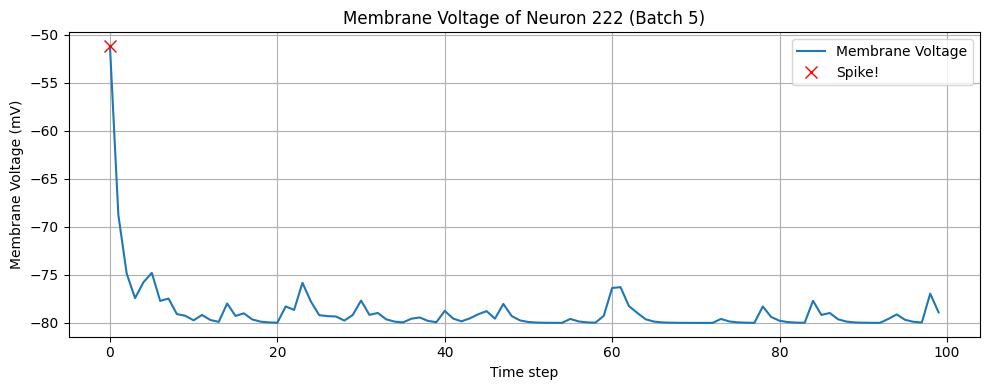

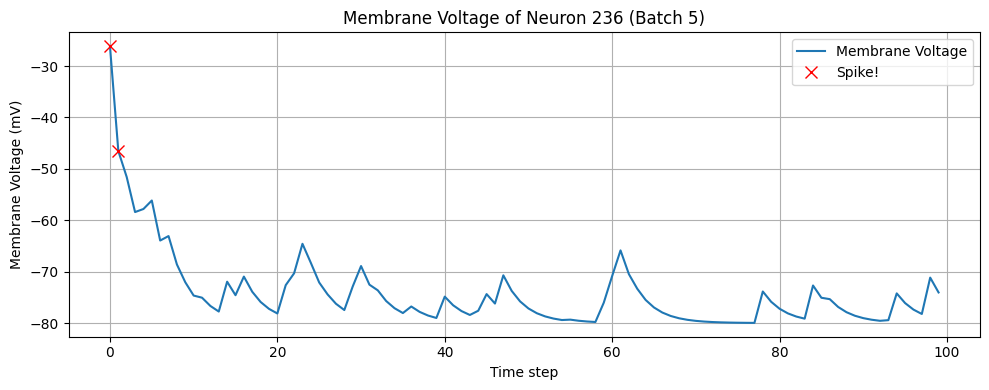

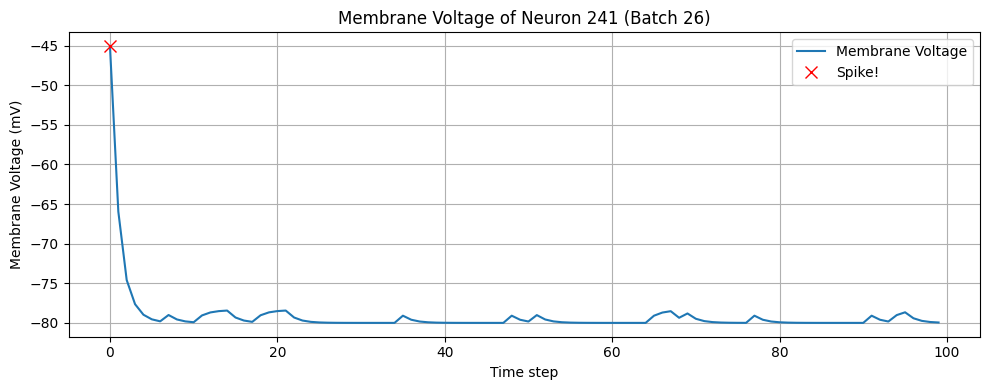

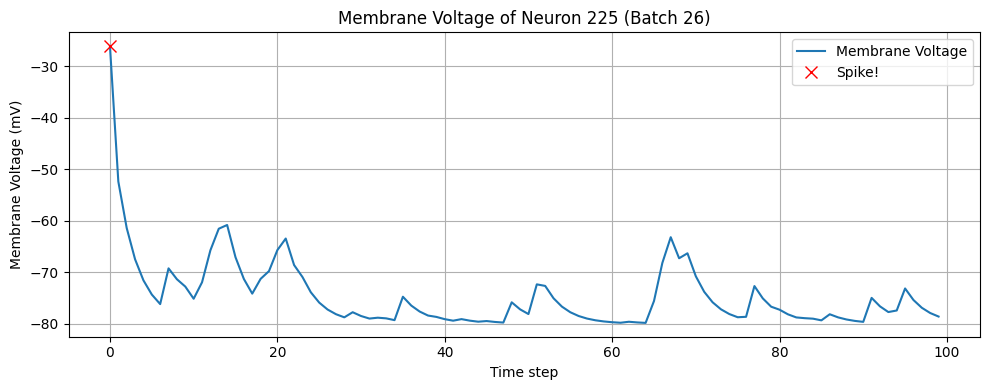

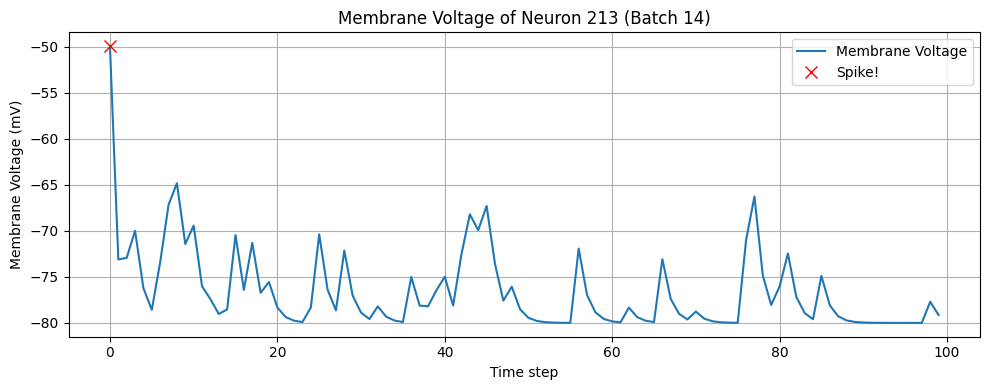

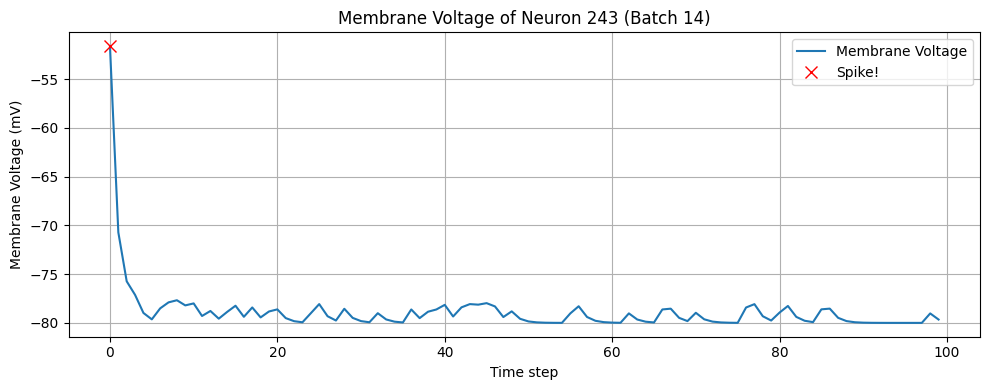


--- CRITICAL DEBUGGING: Batch 0 (Epoch 0, Batch 0) ---
  Model state: training
  time_lag: 5
  Batch size (B): 50
  Timesteps (T): 100
  pred_y_for_loss dtype: torch.float32
  targets_for_loss dtype: torch.float32
  mask dtype: torch.float32
  pred_y_for_loss stats: min=-4.288890, max=3.215816, mean=0.408244
  targets_for_loss stats: min=0.000000, max=90.000000, mean=49.771999
  First sample (pred_y_for_loss[0]) first 15 timesteps:
[-2.2980702   1.6757336   1.2700291   0.          0.          0.
  0.          3.2158155   3.2158155   0.97942775  0.97942775  0.2685616
  0.          0.          0.        ]
  First sample (targets_for_loss[0]) first 15 timesteps:
[ 0. 30. 80. 70. 20. 10. 30. 10. 90. 90. 40. 90. 40. 20. 10.]
  First sample (mask[0]) first 15 timesteps:
[0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
  Expected mask.sum() (B * (T - time_lag)): 4750
  Actual mask.sum().item() for this batch: 4750.000000
  First sample (elementwise_loss[0]) first 15 timesteps:
[5.2811265e+00 8

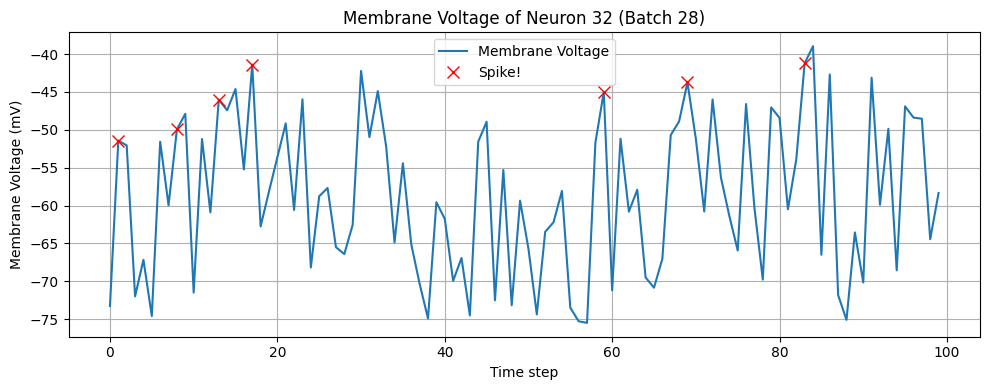

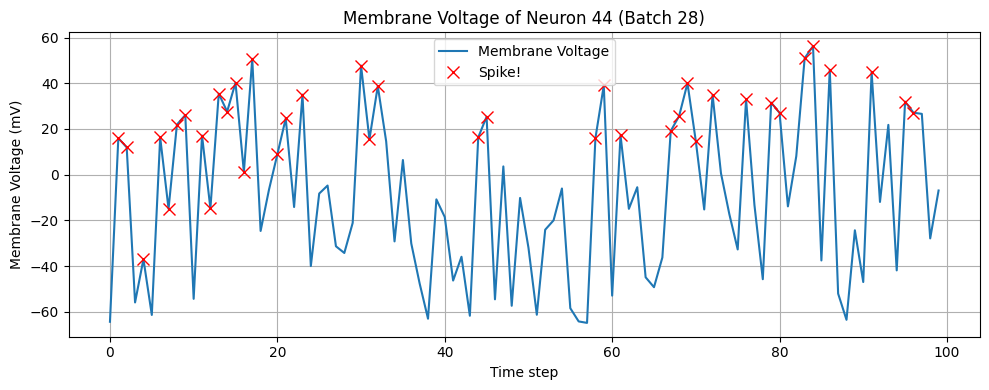

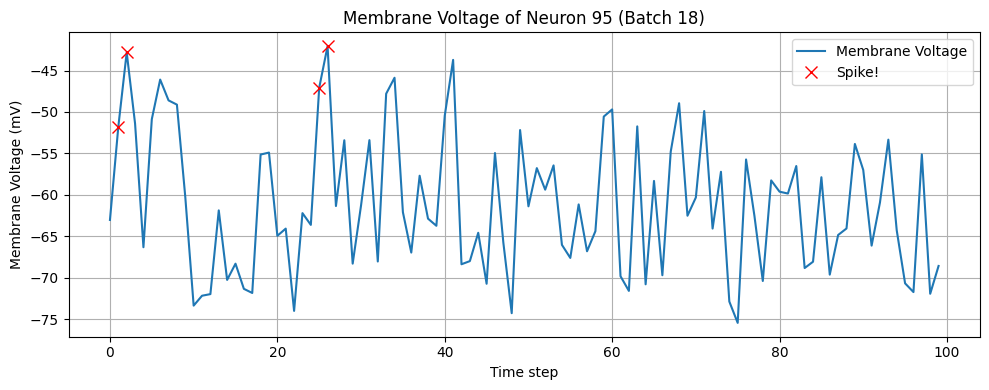

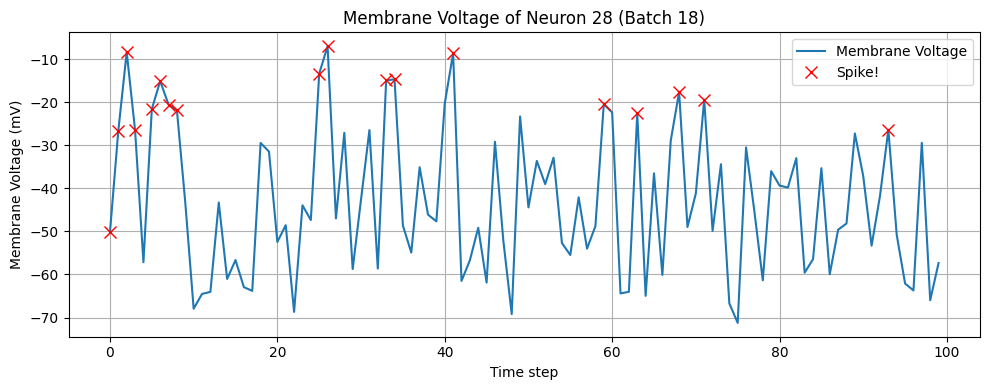

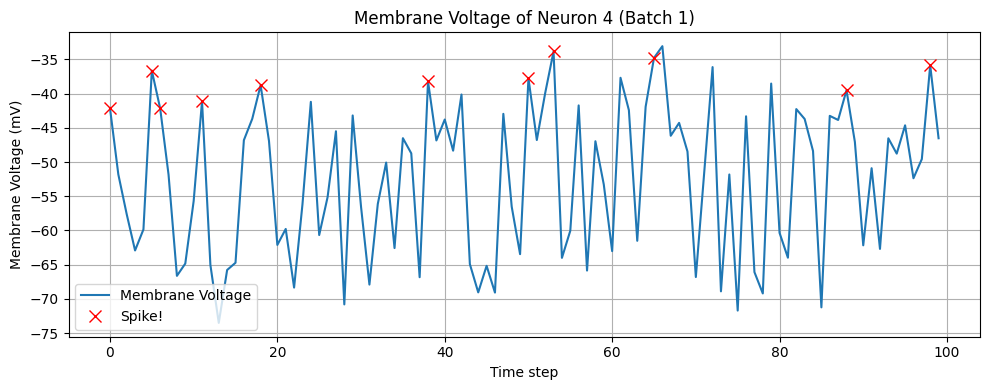

...

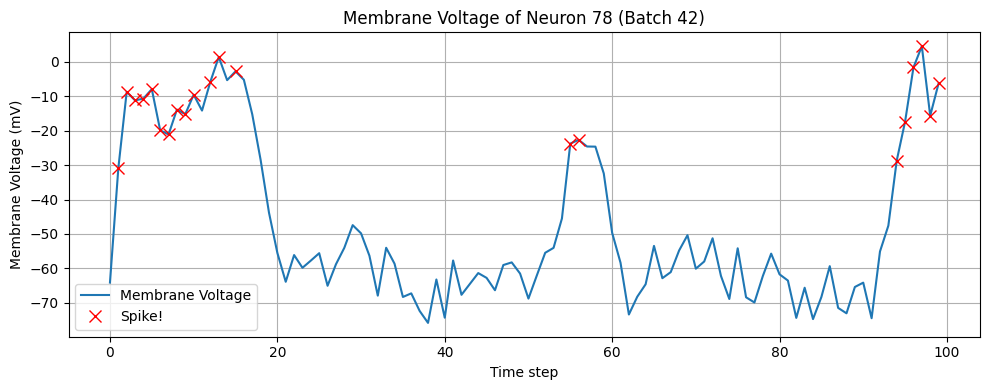

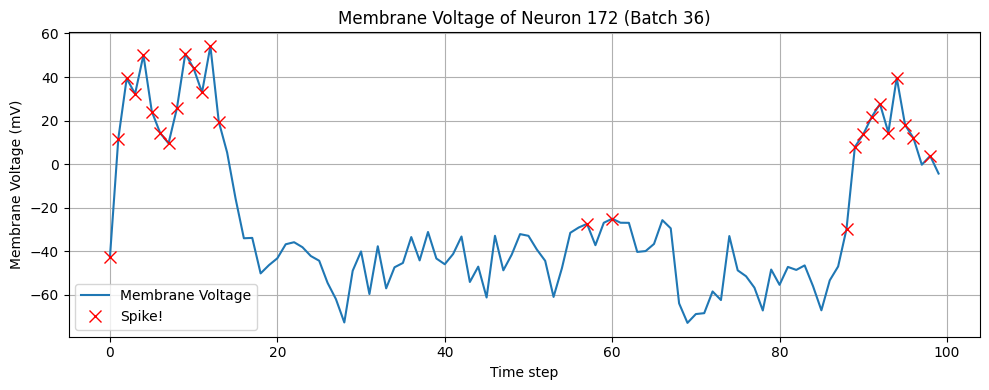

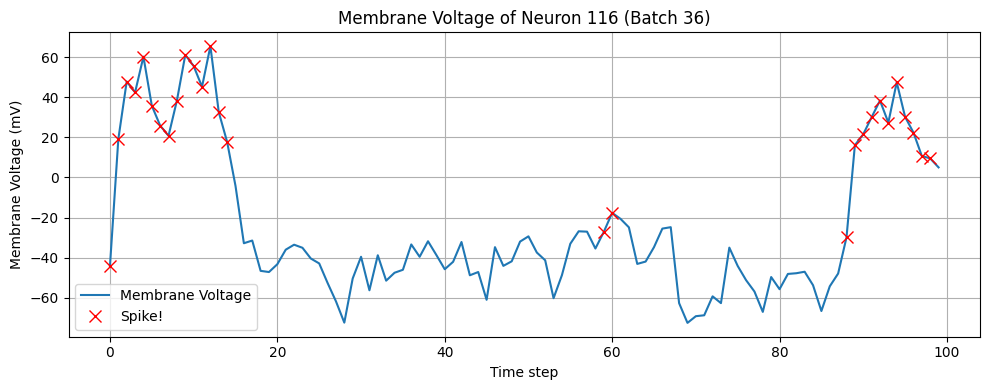

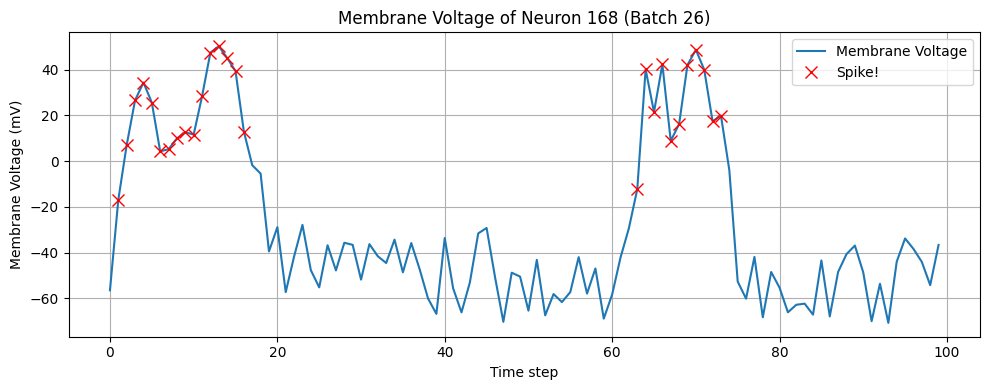

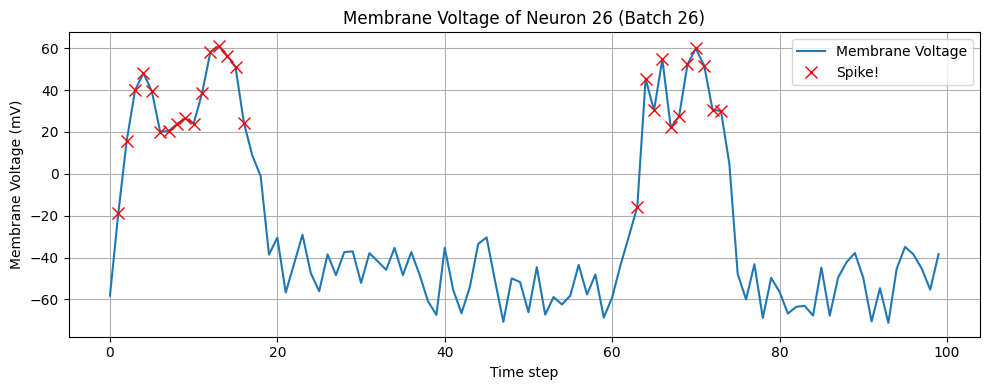

Epoch 0 finished. Average Epoch Loss: 2680.226998

--- Epoch 2/50 ---
Epoch 1 finished. Average Epoch Loss: 1630.446596

--- Epoch 3/50 ---
Epoch 2 finished. Average Epoch Loss: 987.272796

--- Epoch 4/50 ---
Epoch 3 finished. Average Epoch Loss: 681.028143

--- Epoch 5/50 ---
Epoch 4 finished. Average Epoch Loss: 496.040345

--- Epoch 6/50 ---
Epoch 5 finished. Average Epoch Loss: 370.423698

--- Epoch 7/50 ---
Epoch 6 finished. Average Epoch Loss: 283.382166

--- Epoch 8/50 ---
Epoch 7 finished. Average Epoch Loss: 228.023223

--- Epoch 9/50 ---
Epoch 8 finished. Average Epoch Loss: 189.131722

--- Epoch 10/50 ---
Epoch 9 finished. Average Epoch Loss: 163.475558

--- Epoch 11/50 ---
Epoch 10 finished. Average Epoch Loss: 143.860879

--- Epoch 12/50 ---
Epoch 11 finished. Average Epoch Loss: 126.879118

--- Epoch 13/50 ---
Epoch 12 finished. Average Epoch Loss: 112.404095

--- Epoch 14/50 ---
Epoch 13 finished. Average Epoch Loss: 100.605691

--- Epoch 15/50 ---
Epoch 14 finished. Ave

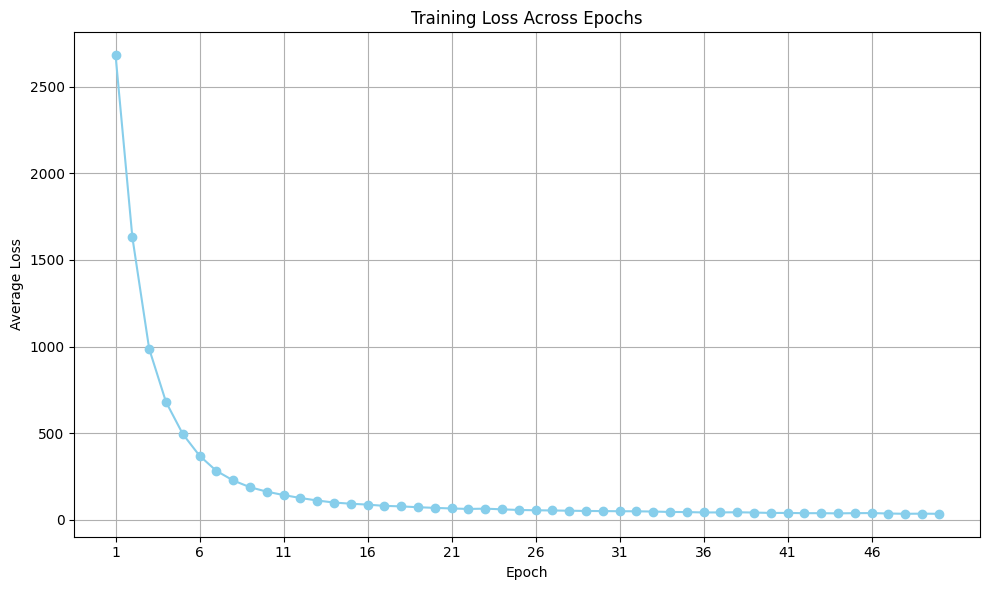

input - Sparsity: 50, E:I: 50
recurrent - Sparsity: 50, E:I: 50
output - Sparsity: 50, E:I: 50


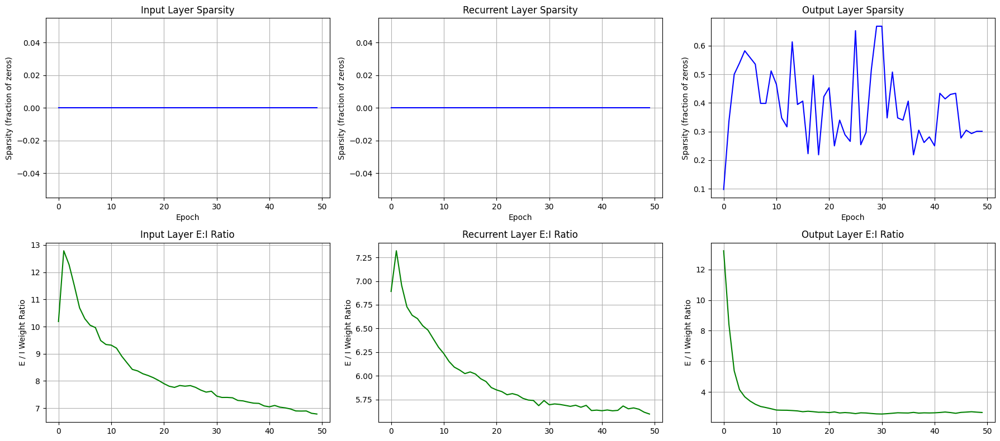

In [ ]:

model = RSNN()


if hasattr(model.rlif1.recurrent, "bias") and model.rlif1.recurrent.bias is not None:
    model.rlif1.recurrent.bias.data.zero_()

# Create training and testing datasets & dataloaders
train_dataset = SequenceRecallDataset(num_samples=2500, seq_length=100, time_lag=1)
test_dataset = SequenceRecallDataset(num_samples=200, seq_length=100, time_lag=5)

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=50, shuffle=False, collate_fn=collate_fn)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=5, shuffle=False, collate_fn=collate_fn)

# Training parameters
optimizer = torch.optim.Adam(model.parameters(), lr=1e-2)
#with torch.no_grad():
    #model.l2.weight.data *= model.output_mask

criterion = nn.MSELoss(reduction='none')
avg_weights = {
    "e_to_out": [],
    "i_to_out": []
    }


job = 0
taskid = 0
ineuron = 0
num_epochs = 50
time_lag=5
num_timesteps = 10  # This is not actively used inside the current code, but required

losses_per_epoch, sparsity_history, ei_ratio_history = train_model16_new2((
    job, model, optimizer, train_loader, criterion, taskid, ineuron,
    num_epochs, num_timesteps, avg_weights, time_lag
))

print("Losses being plotted:")
print(losses_per_epoch[:5], "...", losses_per_epoch[-5:])

plot_loss(losses_per_epoch)

epochs = list(range(len(losses_per_epoch)))

fig, axs = plt.subplots(2, 3, figsize=(18, 8))

for i, layer in enumerate(['input', 'recurrent', 'output']):
    y_sparsity = sparsity_history[layer]
    y_ei = ei_ratio_history[layer]
    
    print(f"{layer} - Sparsity: {len(y_sparsity)}, E:I: {len(y_ei)}")
    
    axs[0, i].plot(epochs[:len(y_sparsity)], y_sparsity, label=f'{layer} sparsity', color='blue')
    axs[0, i].set_title(f'{layer.capitalize()} Layer Sparsity')
    axs[0, i].set_xlabel('Epoch')
    axs[0, i].set_ylabel('Sparsity (fraction of zeros)')
    axs[0, i].grid(True)

    axs[1, i].plot(epochs[:len(y_ei)], y_ei, label=f'{layer} E:I ratio', color='green')
    axs[1, i].set_title(f'{layer.capitalize()} Layer E:I Ratio')
    axs[1, i].set_ylabel('E / I Weight Ratio')
    axs[1, i].grid(True)

plt.tight_layout()
plt.show()


In [364]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def plot_single_neuron(model, batch_idx=None, neuron_idx=None, title=None):
    B, T, N = model.mem1_trace.shape
    b = batch_idx if batch_idx is not None else torch.randint(0, B, (1,)).item()
    n = neuron_idx if neuron_idx is not None else torch.randint(0, N, (1,)).item()
  
    mem = model.mem1_trace[b, :, n].numpy()
    thr = model.thr1_trace[b, :, n].numpy()
    spk = model.spk_flag  [b, :, n].numpy()
    t = np.arange(T)

    plt.figure(figsize=(9,4))
    plt.plot(t, mem, label="Membrane (mV)")
    plt.plot(t, thr, "--", label="Adaptive threshold (mV)")
    idx = np.where(spk > 0.5)[0]
    if idx.size:
        plt.scatter(idx, mem[idx], marker="x", s=60, label="Spike")
    plt.xlabel("Time step"); plt.ylabel("mV (labeled)")
    plt.title(title or f"Batch {b}, Neuron {n}")
    plt.legend(); plt.tight_layout(); plt.show()
    print(f"Plotted batch {b}, neuron {n}")


In [365]:
# 0) Get one batch (make sure shape is (B, T, 1))
# If you already have a tensor called `x` shaped (B, T, 1), skip this.
# x = next(iter(dataloader))[0]            # example if using a DataLoader
# x = x.to(next(model.parameters()).device)

model.eval()
with torch.no_grad():
    # 1) run a forward pass — this fills mem1_trace, thr1_trace, spk_flag
    pred, spks = model(x)                  # x: (batch, seq_len, 1)

# 2) sanity-check shapes
print("mem:", model.mem1_trace.shape)      # expect (B, T, N)
print("thr:", model.thr1_trace.shape)      # expect (B, T, N)
print("spk:", model.spk_flag.shape)        # expect (B, T, N)

# 3) call your plotter
plot_single_neuron(model)                   # random (batch, neuron)
plot_single_neuron(model, batch_idx=0, neuron_idx=0)  # specific one
 

NameError: name 'x' is not defined

In [ ]:
def measure_sparsity(model):
    """
    Measure sparsity of the RSNN model across different connection types and layers.
    
    Parameters:
    -----------
    model : RSNN
        The RSNN model to measure sparsity for
        
    Returns:
    --------
    dict
        Dictionary containing various sparsity metrics
    """
    # Get the weight matrices
    input_weights = model.l1.weight.data
    recurrent_weights = model.rlif1.recurrent.weight.data
    output_weights = model.l2.weight.data
    
    # Calculate overall sparsity for each layer
    input_sparsity = (input_weights == 0).float().mean().item()
    recurrent_sparsity = (recurrent_weights == 0).float().mean().item()
    output_sparsity = (output_weights == 0).float().mean().item()
    
    # Calculate total network sparsity
    total_params = input_weights.numel() + recurrent_weights.numel() + output_weights.numel()
    total_zeros = (input_weights == 0).sum().item() + (recurrent_weights == 0).sum().item() + (output_weights == 0).sum().item()
    total_sparsity = total_zeros / total_params
    
    # Calculate connection-specific sparsity for the recurrent layer
    num_excitatory = model.num_excitatory
    
    # E-E connections
    ee_weights = recurrent_weights[:num_excitatory, :num_excitatory]
    ee_sparsity = (ee_weights == 0).float().mean().item()
    
    # I-I connections
    ii_weights = recurrent_weights[num_excitatory:, num_excitatory:]
    ii_sparsity = (ii_weights == 0).float().mean().item()
    
    # E-I connections
    ei_weights = recurrent_weights[:num_excitatory, num_excitatory:]
    ei_sparsity = (ei_weights == 0).float().mean().item()
    
    # I-E connections
    ie_weights = recurrent_weights[num_excitatory:, :num_excitatory]
    ie_sparsity = (ie_weights == 0).float().mean().item()
    
    # Sparsity for the three inhibitory neuron classes
    num_iPV = model.num_iPV
    num_iSst = model.num_iSst
    num_iHtr = model.num_iHtr
    
    # Calculate indices for each inhibitory class
    pv_start = num_excitatory
    pv_end = pv_start + num_iPV
    sst_start = pv_end
    sst_end = sst_start + num_iSst
    htr_start = sst_end
    htr_end = htr_start + num_iHtr
    
    # Calculate sparsity for each inhibitory class
    pv_sparsity = (recurrent_weights[pv_start:pv_end, :] == 0).float().mean().item()
    sst_sparsity = (recurrent_weights[sst_start:sst_end, :] == 0).float().mean().item()
    htr_sparsity = (recurrent_weights[htr_start:htr_end, :] == 0).float().mean().item()
    
    return {
        'overall': {
            'input_layer': input_sparsity,
            'recurrent_layer': recurrent_sparsity,
            'output_layer': output_sparsity,
            'total_network': total_sparsity
        },
        'connection_specific': {
            'E-E': ee_sparsity,
            'I-I': ii_sparsity,
            'E-I': ei_sparsity,
            'I-E': ie_sparsity
        },
        'inhibitory_classes': {
            'PV': pv_sparsity,
            'Sst': sst_sparsity,
            'Htr': htr_sparsity
        }
    }

model=RSNN()
measure_sparsity(model)

{'overall': {'input_layer': 0.87890625,
  'recurrent_layer': 0.79766845703125,
  'output_layer': 0.84375,
  'total_network': 0.7981619428294574},
 'connection_specific': {'E-E': 0.8396906852722168,
  'I-I': 0.7116493582725525,
  'E-I': 0.759732186794281,
  'I-E': 0.6880918145179749},
 'inhibitory_classes': {'PV': 0.619140625,
  'Sst': 0.5492187738418579,
  'Htr': 0.91943359375}}

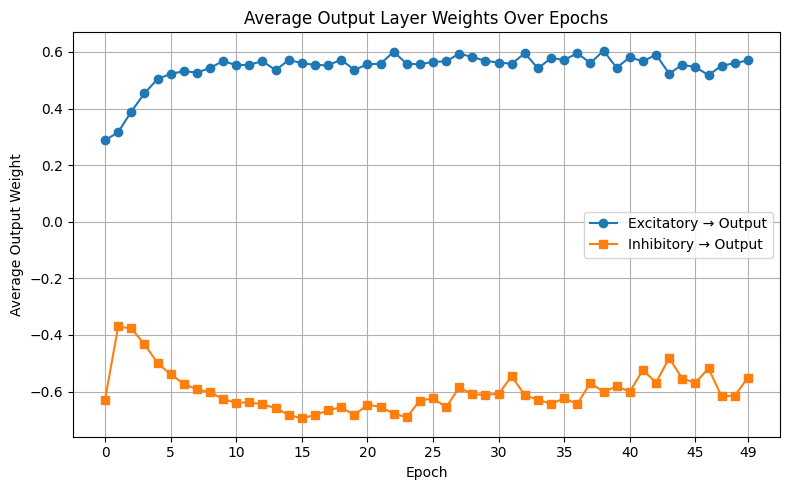

In [ ]:
def plot_weights(avg_weights):
    """
    Plots the average excitatory and inhibitory output weights over epochs.

    Args:
        avg_weights (dict): A dictionary containing 'e_to_out' and 'i_to_out' lists
                            of average weights per epoch.
    """
    if not avg_weights["e_to_out"] or not avg_weights["i_to_out"]:
        print("No weight data to plot. Check if avg_weights were populated during training.")
        return

    epochs = list(range(len(avg_weights["e_to_out"])))

    plt.figure(figsize=(8, 5))
    plt.plot(epochs, avg_weights["e_to_out"], marker='o', label="Excitatory → Output")
    plt.plot(epochs, avg_weights["i_to_out"], marker='s', label="Inhibitory → Output")

    plt.xlabel("Epoch")
    max_epoch = len(epochs) - 1
    if max_epoch >= 0: 
        tick_interval = 5
        x_ticks = list(range(0, max_epoch + 1, tick_interval))
        if max_epoch % tick_interval != 0 and max_epoch not in x_ticks:
            x_ticks.append(max_epoch)
        plt.xticks(x_ticks)
    plt.ylabel("Average Output Weight")
    plt.title("Average Output Layer Weights Over Epochs")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

plot_weights(avg_weights)

In [ ]:
def visualize_sample_output(single_sample_inputs, single_sample_targets, pred_y_single, time_lag, plot_title_suffix=""):
    """
    Plots and prints the comparison of true vs. model output for a single sample.
    
    Args:
        single_sample_inputs (torch.Tensor): Shape (1, seq_len, 1) - input for one sample.
        single_sample_targets (torch.Tensor): Shape (1, seq_len, 1) - true target for one sample.
        pred_y_single (torch.Tensor): Shape (1, seq_len, 1) - model prediction for one sample.
        time_lag (int): The time lag used in the task.
        plot_title_suffix (str): Additional text for the plot title and print statements.
    """
    original_random_sequence_full = single_sample_inputs[0, :, 0].squeeze().cpu().numpy()
    recalled_sequence_full = pred_y_single[0, :, 0].squeeze().cpu().numpy()
    true_target_sequence_full = single_sample_targets[0, :, 0].squeeze().cpu().numpy()

    # finds the first nonzero value 
    recall_start_output_idx = np.where(true_target_sequence_full != 0)[0]
    
    if len(recall_start_output_idx) > 0:
        recall_start_output_idx = recall_start_output_idx[0]

        recall_end_output_idx = recall_start_output_idx + time_lag 
        recall_end_output_idx = min(recall_end_output_idx, len(true_target_sequence_full))

        original_segment_start = 0
        original_segment_end = time_lag 
        
        original_recalled_input_segment = original_random_sequence_full[original_segment_start : original_segment_end]
        model_recalled_output_segment = recalled_sequence_full[recall_start_output_idx : recall_end_output_idx]
        true_recalled_target_segment = true_target_sequence_full[recall_start_output_idx : recall_end_output_idx]

        print(f"\n--- {plot_title_suffix} Analysis ---")
        print(f"Time lag setting: {time_lag}")
        print(f"Recall expected to start at output index: {recall_start_output_idx}")

        print("\nOriginal Random Sequence Segment:")
        print(original_recalled_input_segment)
        print(f"Length: {len(original_recalled_input_segment)}")

        print("\nModel's Recalled Output Segment:")
        print(model_recalled_output_segment)
        print(f"Length: {len(model_recalled_output_segment)}")

        print("\nTrue Target Recalled Segment:")
        print(true_recalled_target_segment)
        print(f"Length: {len(true_recalled_target_segment)}")

        print("\n--- Full Sequences (for context) ---")
        print("\nOriginal Random Sequence (Full):")
        print(original_random_sequence_full)
        print(f"Shape: {original_random_sequence_full.shape}")

        print("\nRecalled Sequence (Model Output - Full):")
        print(recalled_sequence_full)
        print(f"Shape: {recalled_sequence_full.shape}")

        print("\nTrue Target Sequence (Ground Truth - Full):")
        print(true_target_sequence_full)
        print(f"Shape: {true_target_sequence_full.shape}")

        # --- Plotting Section ---
        plt.figure(figsize=(14, 6))
        
        plt.plot(true_target_sequence_full, label='True Target Output', color='blue', linestyle='-', marker='o', markersize=4)
        plt.plot(recalled_sequence_full, label='Model Recalled Output', color='red', linestyle='--', marker='x', markersize=4)
        plt.plot(original_random_sequence_full, label='Original Input Sequence', color='green', linestyle=':', alpha=0.7)
        
        plt.axvline(x=recall_start_output_idx, color='gray', linestyle='-.', label='Recall Start')
        
        plt.title(f"Memory Capacity Task: Sample Output Visualization {plot_title_suffix} (Time Lag = {time_lag})")
        plt.xlabel("Timestep")
        plt.ylabel("Numerical Value")
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.tight_layout()
        plt.show()

    else:
        print(f"No non-zero values found in the true target sequence for {plot_title_suffix}. This sample might not have a recall event.")

In [ ]:
'''print("\n[Post-Training] Evaluating Last Training Batch (Loaded from File):")

# Load the exact same batch used during training
omega_input, labels = torch.load('last_batch.pt')

# Ensure model is in eval mode and reset its internal state
model.eval()
if hasattr(model, 'reset_states'):
    model.reset_states()

# Predict
with torch.no_grad():
    pred_y, _ = model(omega_input)

# Visualize or print predictions vs targets
print(f"\n--- Confirming data sent to Last Batch visualization ---")
print(f"Pred Y for last batch (sample 0, first 15): {pred_y[0, :15, 0].squeeze().cpu().numpy()}")
print(f"True Target for last batch (sample 0, first 15): {labels[0, :15, 0].squeeze().cpu().numpy()}")
print("----------------------------------------------------------\n")

visualize_sample_output(
    omega_input[0:1],
    labels[0:1],
    pred_y[0:1],
    time_lag,
    "Last Batch Sample (Post-Training - Loaded from File)"
)'''

'print("\n[Post-Training] Evaluating Last Training Batch (Loaded from File):")\n\n# Load the exact same batch used during training\nomega_input, labels = torch.load(\'last_batch.pt\')\n\n# Ensure model is in eval mode and reset its internal state\nmodel.eval()\nif hasattr(model, \'reset_states\'):\n    model.reset_states()\n\n# Predict\nwith torch.no_grad():\n    pred_y, _ = model(omega_input)\n\n# Visualize or print predictions vs targets\nprint(f"\n--- Confirming data sent to Last Batch visualization ---")\nprint(f"Pred Y for last batch (sample 0, first 15): {pred_y[0, :15, 0].squeeze().cpu().numpy()}")\nprint(f"True Target for last batch (sample 0, first 15): {labels[0, :15, 0].squeeze().cpu().numpy()}")\nprint("----------------------------------------------------------\n")\n\nvisualize_sample_output(\n    omega_input[0:1],\n    labels[0:1],\n    pred_y[0:1],\n    time_lag,\n    "Last Batch Sample (Post-Training - Loaded from File)"\n)'

In [ ]:
def plot_raster(spikes_single_sample, max_neurons=260, title_suffix="", original_T_max=None):
    """
    Plots a raster plot for a single sample's spike train.

    Args:
        spikes_single_sample (torch.Tensor): A 2D tensor of spikes for a single sample.
                                            Expected shape: (time_steps, num_neurons).
                                            Values should be 0 or 1 (or close to it).
        max_neurons (int): The maximum number of neurons to display in the plot.
                           If the sample has more neurons, only the first `max_neurons`
                           will be plotted.
        title_suffix (str): Additional text to append to the plot title (e.g., sample ID).
        original_T_max (int, optional): The true (unpadded) time length of the sequence.
                                        If provided, it will be used to set the x-axis limit
                                        to focus on the active part of the sequence.
                                        If None, the full length of `spikes_single_sample`
                                        will be used for the x-axis.
    """
    if spikes_single_sample.dim() != 2:
        raise ValueError(
            f"Expected 'spikes_single_sample' to have 2 dimensions (time, neurons), "
            f"but got {spikes_single_sample.shape}. "
            "Ensure you're passing a single sample (e.g., after squeezing the batch dim)."
        )

    
    spikes_np = spikes_single_sample.cpu().numpy()

    time_steps, num_neurons = spikes_np.shape

    
    num_neurons_to_plot = min(max_neurons, num_neurons)

    
    x_limit = original_T_max if original_T_max is not None else time_steps

    plt.figure(figsize=(14, 6))
    
    
    for neuron_idx in range(num_neurons_to_plot):
        # We check for values > 0.5 to handle potential floating-point spikes
        spike_times = np.where(spikes_np[:, neuron_idx] > 0.5)[0]
        plt.vlines(spike_times, neuron_idx + 0.5, neuron_idx + 1.5, color='black', lw=2.0)

    plt.xlabel("Timestep")
    plt.ylabel("Neuron Index")
    plt.title(f"Raster Plot for {num_neurons_to_plot} Neurons {title_suffix}")
    plt.ylim(0.5, num_neurons_to_plot + 0.5) 
    plt.xlim(0, x_limit) 
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()



--- Average Firing Rate Statistics Across All Batches (True Rates) ---
Min average firing rate per neuron: 0.0
Max average firing rate per neuron: 0.765748
Mean average firing rate across all neurons: 0.03363036
Number of silent neurons (on average): 183


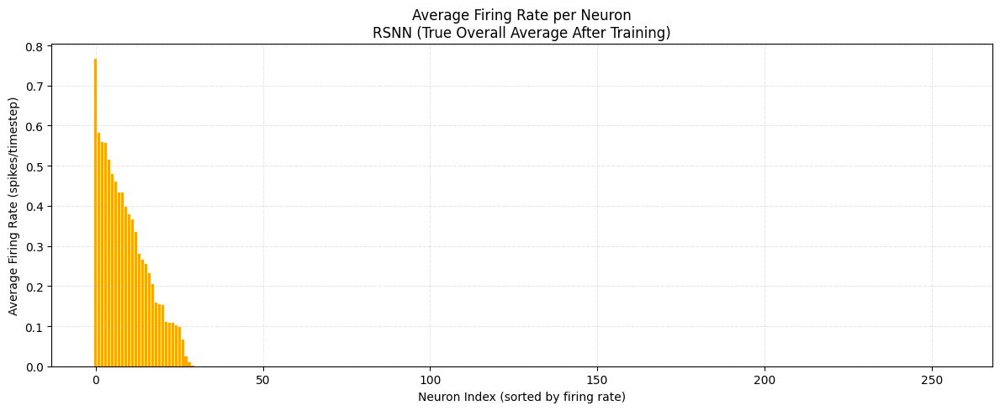

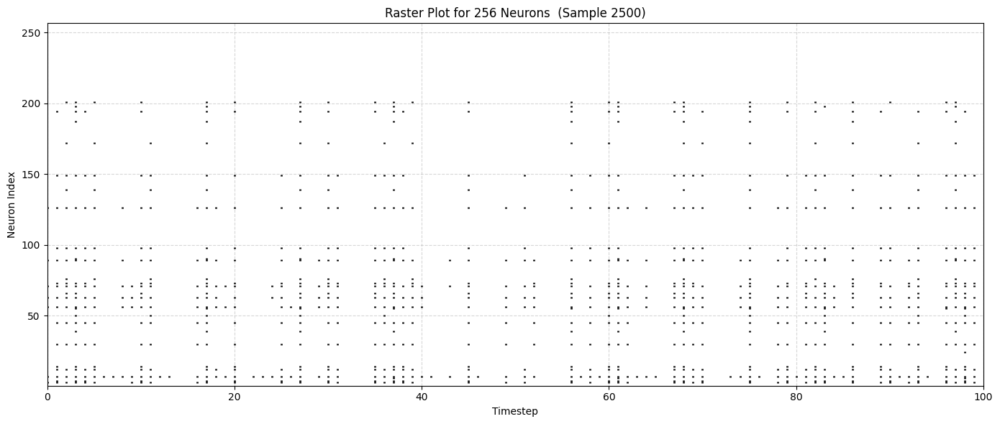

In [ ]:
import torch.nn.functional as F

model.eval()
all_spikes_across_batches_unpadded = []

# Iterate through the dataloader again to collect spikes
with torch.no_grad():
    for batch_idx, (inputs, targets) in enumerate(train_loader):
        # Now there's only one input, which is 'inputs' itself
        # 'inputs' will have shape (batch_size, seq_len, 1)
        
        # spikes_batch will have shape (batch_size, T_max_current_sample, Num_Neurons)
        _, spikes_batch = model(inputs) # Pass the single input tensor
        
        # Append each sample's spikes individually
        for i in range(spikes_batch.shape[0]):
            all_spikes_across_batches_unpadded.append(spikes_batch[i:i+1])


if all_spikes_across_batches_unpadded:
    # Calculate Average Firing Rates (Accurately, per original length)
    all_per_neuron_rates = []
    for i, spikes_tensor in enumerate(all_spikes_across_batches_unpadded):
        # spikes_tensor is (1, T_max_current_sample, Num_Neurons) for each appended sample
        current_T_max = spikes_tensor.shape[1]
        if current_T_max > 0:
            rate_this_sample = spikes_tensor.squeeze(0).float().mean(dim=0) # (Num_Neurons,)
            all_per_neuron_rates.append(rate_this_sample)
        else:
            print(f"Warning: Sample {i} has T_max = 0. Skipping for firing rate calculation.")
            # Ensure a tensor of zeros with correct neuron dimension is appended
            all_per_neuron_rates.append(torch.zeros(spikes_tensor.shape[2])) 

    if all_per_neuron_rates:
        firing_rates_avg_true = torch.stack(all_per_neuron_rates).mean(dim=0).detach().numpy()

        print("\n--- Average Firing Rate Statistics Across All Batches (True Rates) ---")
        print("Min average firing rate per neuron:", firing_rates_avg_true.min())
        print("Max average firing rate per neuron:", firing_rates_avg_true.max())
        print("Mean average firing rate across all neurons:", firing_rates_avg_true.mean())
        print("Number of silent neurons (on average):", (firing_rates_avg_true == 0).sum())

        
        def plot_firing_rate_from_calculated_rates(calculated_rates_np, num_neurons_total, model_description="RSNN Model"):
            sorted_indices = np.argsort(calculated_rates_np)[::-1]
            sorted_rates = calculated_rates_np[sorted_indices]

            plt.figure(figsize=(12, 5))
            plt.bar(range(num_neurons_total), sorted_rates, color='orange')
            plt.xlabel("Neuron Index (sorted by firing rate)")
            plt.ylabel("Average Firing Rate (spikes/timestep)")
            plt.title(f"Average Firing Rate per Neuron\n{model_description}")
            plt.tight_layout()
            plt.grid(True, linestyle='--', alpha=0.3)
            plt.show()

        # You need to pass the actual number of neurons in your model here
        plot_firing_rate_from_calculated_rates(firing_rates_avg_true, model.num_hidden, # Use model.num_neurons
                                               model_description="RSNN (True Overall Average After Training)")
    else:
        print("No valid samples to calculate true firing rates.")


    # Plot Raster Plots (individually)
    last_sample_spikes_unpadded = all_spikes_across_batches_unpadded[-1].squeeze(0)
    neurons_to_show_per_plot = 256 # This can be adjusted based on your preference

    #for i in range(num_samples_to_plot_actual):
        #sample_spikes_unpadded = all_spikes_across_batches_unpadded[i].squeeze(0)
        
    plot_raster(last_sample_spikes_unpadded, 
                    max_neurons=neurons_to_show_per_plot, 
                    title_suffix=f" (Sample {i+1})",
                   )

else:
    print("No spikes collected. Dataloader might be empty or loop didn't run.")

In [ ]:
total_loss = 0.0
total_points = 0.0

model.eval()
with torch.no_grad():
    for inputs, targets in train_loader:
        pred_y, _ = model(inputs)
        pred_y = pred_y.squeeze(-1)
        targets = targets.squeeze(-1)

        B, T = targets.shape
        time_mask = torch.zeros((T,), device=targets.device)
        time_mask[time_lag:] = 1.0
        mask = time_mask.unsqueeze(0).expand(B, -1).float()

        elementwise_loss = criterion(pred_y, targets)
        masked_loss = elementwise_loss * mask

        total_loss += masked_loss.sum().item()
        total_points += mask.sum().item()

final_avg_loss = total_loss / (total_points + 1e-8)
print(f"[Manual Eval] Final averaged loss per timestep: {final_avg_loss:.2f}")

[Manual Eval] Final averaged loss per timestep: 3126.79
